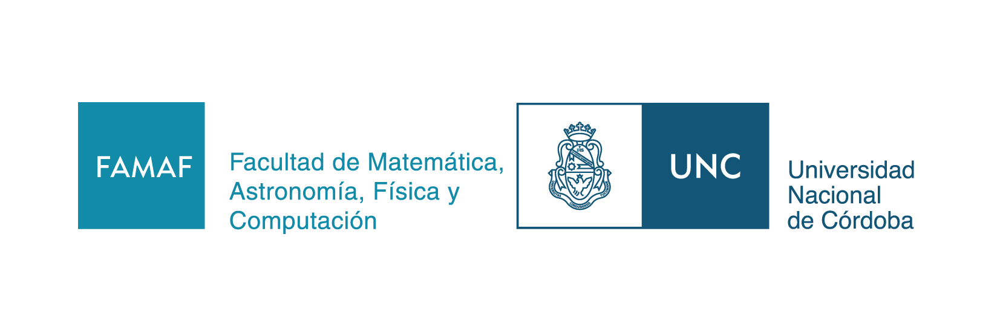
#Optativa Series de Tiempo

# Introducción a las Series de tiempo
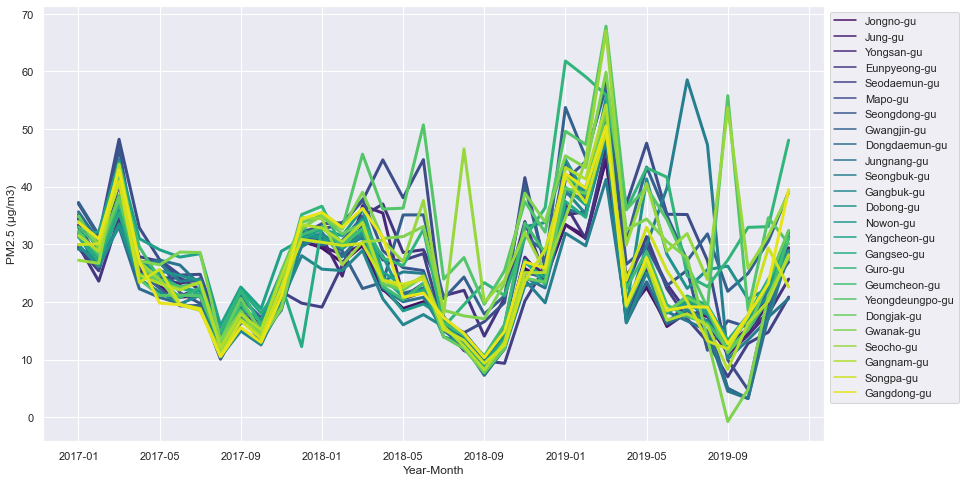

## Examen Media Materia

Para aprobar hay que entregar este archivo con la información pedida y comentada.



 ### Problema 1:

- Realice gráficos de los seis contaminantes en Seoul, siguiendo la notebook **Opt. Series de tiempo_2_b.ipynb** con los datos sin curar, agregando las cuatro lineas de valores que estan especificados la tabla de niveles de seguridad, en una sola figura, un subplot bajo el otro para comparación simultánea. Listo

- Rehacer el gráfico anterior eliminando ceros y valores negativos. Listo

 ### Problema 2:

- Objetivo de este problema: Estudiar la demanda mensual de energia electrica en Victoria.


- Realice los siguientes gráficos siguiendo la notebook **Opt. Series de tiempo_2_a.ipynb**

    - Gráfico de radar

    - Gráfico de barra circular

    - Gráfico de ploteo radial

 Diga cual de los trés gráficos provee mejor información visual, y arme una única imagen con todos los gráficos realizados

### Problema 3:

- Objetivo de este problema: Realizar descomposiciones en tendencia y estacionalidad aditiva y multiplicativa (seasonal_decompose) para los gases de madrid 'NO_2' y 'CO' que estudiamos en la notebook **Opt. Series de tiempo_4 ipynb**  

- Dar una opinion de lo observado.

### Problema 4:

- Objetivo de este problema: Realizar suavizado exponencial, suavizado de Holt y suavizado de Holt-Winter  para los gases de madrid 'NO_2' y 'CO' que estudiamos en la  notebook **Opt. Series de tiempo_4 ipynb**  .

- Encontrar los parámetros generando un set de validación y MSE.

- Predecir usando TODA la serie (train mas validacion) y comparar con TEST .

- Plotear la serie completa y la prediccion para observar el comportamiento de cada uno de los suavizados.

- Dar una opinion de la bondad del método para estas series.


# Resolución de Problemas

## Problema 1 · Calidad del aire en Seúl

Siguiendo la metodología de Opt. Series de tiempo_2_b.ipynb cargamos el conjunto de Measurement_summary.csv y trabajamos sobre la estación 101 para conservar la narrativa original: primero miramos las series crudas y luego repetimos el análisis sin valores nulos, ceros ni negativos.

In [1]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.offline as py
from IPython.display import display, Markdown

pd.options.mode.chained_assignment = None
py.init_notebook_mode(connected=True)

## Problema 1 · Calidad del aire en Seúl

Siguiendo la metodología de `Opt. Series de tiempo_2_b.ipynb` cargamos el conjunto de `Measurement_summary.csv` y trabajamos sobre la estación 101 para conservar la narrativa original: primero miramos las series crudas y luego repetimos el análisis sin valores nulos, ceros ni negativos.

In [15]:
#Leemos los archivos
seoul_path = 'AirPollutionSeoul/'

stations = pd.read_csv(seoul_path + 'Measurement_station_info.csv')
measurements = pd.read_csv(seoul_path + 'Measurement_info.csv')
items = pd.read_csv(seoul_path + 'Measurement_item_info.csv')

seoul_df = seoul_path + 'Measurement_summary.csv'

seoul_df = pd.read_csv(seoul_df, parse_dates=['Measurement date'])
seoul_df.sort_values('Measurement date', inplace=True)

seoul_df.head()

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
0,2017-01-01,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.059,0.002,1.2,73.0,57.0
51810,2017-01-01,103,"136, Hannam-daero, Yongsan-gu, Seoul, Republic...",37.540033,127.004850,0.005,0.039,0.002,1.4,70.0,68.0
595702,2017-01-01,124,"236, Baekjegobun-ro, Songpa-gu, Seoul, Republi...",37.502686,127.092509,0.006,0.040,0.003,1.4,60.0,51.0
77714,2017-01-01,104,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848,0.005,0.045,0.003,0.6,73.0,46.0
569798,2017-01-01,123,"426, Hakdong-ro, Gangnam-gu, Seoul, Republic o...",37.517528,127.047470,0.005,0.040,0.002,0.8,63.0,48.0


In [8]:
pollutant_cols = items['Item name'].unique().tolist()
pollutant_cols

['SO2', 'NO2', 'CO', 'O3', 'PM10', 'PM2.5']

In [11]:
#seleccionamos los datos de la estación 101 para análisis
station_code = 101
station_series = seoul_df.loc[seoul_df['Station code'] == station_code, ['Measurement date', 'Station code'] + pollutant_cols].copy()
station_series.reset_index(drop=True, inplace=True)

print((f"Registros disponibles para la estación {station_code}: {len(station_series):,}"))

display(station_series.head())

Registros disponibles para la estación 101: 25,905


,Measurement date,Station code,SO2,NO2,CO,O3,PM10,PM2.5
0,2017-01-01 00:00:00,101,0.004,0.059,1.2,0.002,73.0,57.0
1,2017-01-01 01:00:00,101,0.004,0.058,1.2,0.002,71.0,59.0
2,2017-01-01 02:00:00,101,0.004,0.056,1.2,0.002,70.0,59.0
3,2017-01-01 03:00:00,101,0.004,0.056,1.2,0.002,70.0,58.0
4,2017-01-01 04:00:00,101,0.003,0.051,1.2,0.002,69.0,61.0


In [13]:
pollutant_levels = {
    'SO2': [0.02, 0.05, 0.15, 1],
    'NO2': [0.03, 0.06, 0.2, 2],
    'CO': [2, 9, 15, 50],
    'O3': [0.03, 0.09, 0.15, 0.5],
    'PM2.5': [15, 35, 75, 500],
    'PM10': [30, 80, 150, 600]
}
quality_levels = ['Good', 'Normal', 'Bad', 'Very Bad']
seoul_standard = pd.DataFrame(pollutant_levels, index=quality_levels)



print(('Referencias de calidad del aire según Opt. sdt 2b'))
display(seoul_standard)

Referencias de calidad del aire según Opt. sdt 2b


,SO2,NO2,CO,O3,PM2.5,PM10
Good,0.02,0.03,2,0.03,15,30
Normal,0.05,0.06,9,0.09,35,80
Bad,0.15,0.20,15,0.15,75,150
Very Bad,1.00,2.00,50,0.50,500,600


In [18]:
level_palette = {
    'Good': '#2ecc71',
    'Normal': '#f39c12',
    'Bad': '#e74c3c',
    'Very Bad': '#8e44ad'
}

def plot_pollutants(df_input, title):
    fig = make_subplots(
        rows=len(pollutant_cols),
        cols=1,
        shared_xaxes=True,
        vertical_spacing=0.02,
        subplot_titles=[f'{col} - Evolución Temporal' for col in pollutant_cols]
    )

    x_values = df_input['Measurement date']
    x_text_point = x_values.iloc[int(len(x_values) * 0.95)]

    for idx, pollutant in enumerate(pollutant_cols, start=1):
        fig.add_trace(
            go.Scatter(
                x=x_values,
                y=df_input[pollutant],
                mode='lines',
                name=pollutant,
                line=dict(width=1.2)
            ),
            row=idx,
            col=1
        )
#Lineas de punto mostrando nuveles de calidad de aire
        for level_name in quality_levels:
            level_value = seoul_standard[pollutant].loc[level_name]
            fig.add_hline(
                y=level_value,
                line_dash='dot',
                line_color=level_palette[level_name],
                line_width=1,
                row=idx,
                col=1
            )
            fig.add_annotation(
                x=x_text_point,
                y=level_value,
                text=level_name,
                showarrow=False,
                font=dict(color=level_palette[level_name], size=10),
                xanchor='right',
                row=idx,
                col=1
            )

    fig.update_layout(
        height=1600,
        width=950,
        title=title,
        showlegend=False,
        template='plotly_white'
    )
    fig.update_xaxes(matches='x')
    fig.show()


print(('Series completas sin curar'))
plot_pollutants(station_series, f'Estación {station_code} · datos originales')

Series completas sin curar


In [17]:
mask_bad = (station_series[pollutant_cols] <= 0) | station_series[pollutant_cols].isna()
clean_station = station_series.loc[~mask_bad.any(axis=1)].copy()
removed_rows = len(station_series) - len(clean_station)

print((f"Registros eliminados por valores no físicos: {removed_rows}"))

plot_pollutants(clean_station, f'Estación {station_code} · sin ceros ni negativos')

Registros eliminados por valores no físicos: 134


Conclusión:

## Problema 2 · Demanda eléctrica en Victoria

A partir de la notebook `Opt. Series de tiempo_2_a.ipynb` y del material complementario de demanda eléctrica replicamos los gráficos polares (radar, barra circular y radial) usando el set `vic_elec` agregado a frecuencia mensual.

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style('whitegrid')

In [35]:
dem_vic_path = "Demanda_elec_victoria\\vic_elec.csv"
vic = pd.read_csv(dem_vic_path, parse_dates=['Time'])
vic.head()

,Time,Demand,Temperature,Date,Holiday
0,2011-12-31 13:00:00,4382.825174,21.40,2012-01-01,True
1,2011-12-31 13:30:00,4263.365526,21.05,2012-01-01,True
2,2011-12-31 14:00:00,4048.966046,20.70,2012-01-01,True
3,2011-12-31 14:30:00,3877.563330,20.55,2012-01-01,True
4,2011-12-31 15:00:00,4036.229746,20.40,2012-01-01,True


In [36]:
#Generamos nuevo indice , nan si hay espacios vacíos
vic = vic.set_index('Time').asfreq('30min').sort_index()

#pasamos a mensual
monthly_demand = vic['Demand'].resample('MS').mean().to_frame('Demand_MW')
monthly_demand['Month'] = monthly_demand.index.month
monthly_demand['MonthName'] = monthly_demand.index.strftime('%b')
monthly_demand['Year'] = monthly_demand.index.year

#tomamos el último año disponible
latest_year = monthly_demand['Year'].max()
victoria_profile = monthly_demand.loc[monthly_demand['Year'] == latest_year].sort_values('Month').copy()

display((f"Serie mensual del {latest_year} (12 registros)"))
display(victoria_profile[['MonthName', 'Demand_MW']])

'Serie mensual del 2014 (12 registros)'

,MonthName,Demand_MW
Time,,
2014-01-01,Jan,4836.363077
2014-02-01,Feb,4810.643083
2014-03-01,Mar,4408.430482
2014-04-01,Apr,4355.930372
2014-05-01,May,4560.058810
2014-06-01,Jun,4820.535700
2014-07-01,Jul,5090.494815
2014-08-01,Aug,4883.170402
2014-09-01,Sep,4516.333887


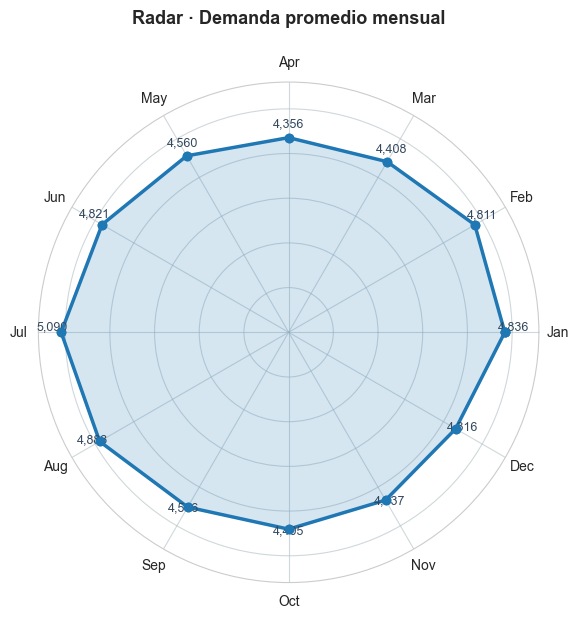

In [46]:
month_labels = victoria_profile['MonthName'].tolist()
color_sequence = sns.color_palette('viridis', n_colors=len(victoria_profile))

def build_radar(df_input):
    values = df_input["Demand_MW"].values
    values = np.concatenate([values, [values[0]]])
    angles = np.linspace(0, 2 * np.pi, len(df_input) + 1)

    fig, ax = plt.subplots(figsize=(6.5, 6.5), subplot_kw=dict(polar=True))
    ax.plot(angles, values, color="#1f77b4", linewidth=2.5, marker="o")
    ax.fill(angles, values, color="#1f77b4", alpha=0.18)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(df_input["MonthName"])
    ax.set_ylim(0, values.max() * 1.1)
    ax.set_yticklabels([])
    ax.set_title("Radar · Demanda promedio mensual", y=1.1, fontsize=13, fontweight="bold")
    ax.grid(color="#b0bec5", alpha=0.6)
    ax.scatter(angles, values, color="#1f77b4", zorder=5)
    for ang, val, month in zip(angles[:-1], values[:-1], df_input["MonthName"]):
        ax.text(ang, val * 1.04, f"{val:,.0f}", ha="center", va="bottom", fontsize=9, color="#34495e")
    plt.show()

build_radar(victoria_profile)


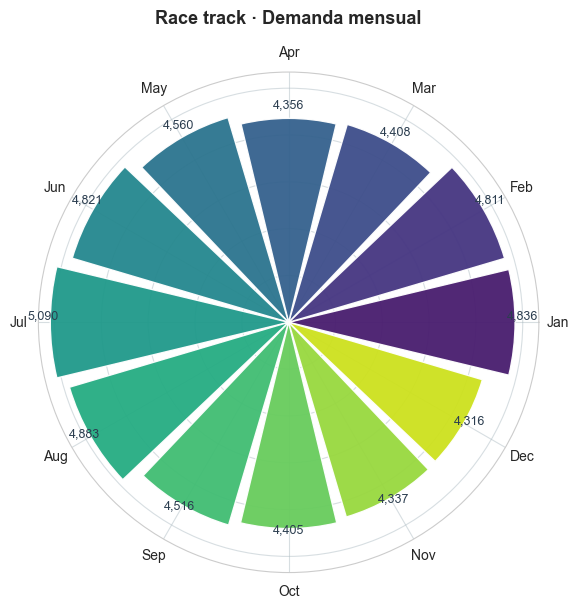

In [51]:
def build_circular_bar(df_input):
    angles = np.linspace(0, 2 * np.pi, len(df_input), endpoint=False)
    widths = (2 * np.pi) / len(df_input)
    radii = df_input["Demand_MW"].values

    fig, ax = plt.subplots(figsize=(6.5, 6.5), subplot_kw=dict(polar=True))
    bars = ax.bar(
        angles,
        radii,
        width=widths * 0.9,
        color=color_sequence,
        alpha=0.95,
        edgecolor="white",
        linewidth=1,
    )
    ax.set_xticks(angles)
    ax.set_xticklabels(df_input["MonthName"])
    ax.set_yticklabels([])
    ax.set_title("Race track · Demanda mensual", y=1.08, fontsize=13, fontweight="bold")
    ax.grid(color="#b0bec5", alpha=0.5)
    for bar, ang, val in zip(bars, angles, radii):
        ax.text(
            ang,
            bar.get_height() + radii.max() * 0.03,
            f"{val:,.0f}",
            ha="center",
            va="bottom",
            fontsize=9,
            color="#2c3e50",
        )
    plt.show()
build_circular_bar(victoria_profile)


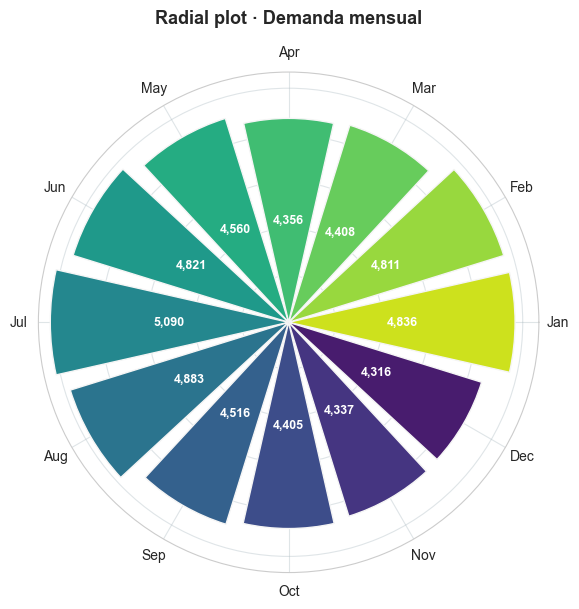

In [50]:
def build_radial_plot(df_input):
    angles = np.linspace(0, 2 * np.pi, len(df_input), endpoint=False)
    width = (2 * np.pi) / len(df_input)
    heights = df_input["Demand_MW"].values
    colors = sns.color_palette("viridis", len(df_input))[::-1]

    fig, ax = plt.subplots(figsize=(6.5, 6.5), subplot_kw=dict(polar=True))
    bars = ax.bar(
        angles,
        heights,
        width=width * 0.85,
        bottom=0,
        color=colors,
        edgecolor="#f5f5f5",
        linewidth=1,
    )
    ax.set_xticks(angles)
    ax.set_xticklabels(df_input["MonthName"])
    ax.set_yticklabels([])
    ax.set_title("Radial plot · Demanda mensual", y=1.08, fontsize=13, fontweight="bold")
    ax.grid(color="#b0bec5", alpha=0.4)
    for bar, ang, val in zip(bars, angles, heights):
        ax.text(ang, val * 0.5, f"{val:,.0f}", ha="center", va="center", color="white", fontsize=9, fontweight="bold")
    plt.show()
build_radial_plot(victoria_profile)

La barra circular permite ver de forma inmediata los saltos entre meses consecutivos (especialmente los máximos estivales y mínimos invernales), por lo que resulta la visualización más informativa para diagnosticar desbalances en la demanda mensual.

## Problema 3 · Descomposición aditiva y multiplicativa

Reutilizamos el flujo de `Opt. Series de tiempo_4.ipynb` para consolidar todos los CSV de Madrid, promediarlos por día y luego por mes antes de aplicar `seasonal_decompose` a los gases NO₂ y CO.

In [53]:
from pathlib import Path
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.dates as mdates

csv_dir = Path('csvs_per_year/csvs_per_year/csvs_per_year')
csv_files = sorted(csv_dir.glob('madrid_*.csv'))

madrid = pd.concat((pd.read_csv(file) for file in csv_files), ignore_index=True)
madrid['date'] = pd.to_datetime(madrid['date'])
daily_mean = madrid.groupby('date').mean().sort_index()

monthly_pollutants = daily_mean.resample('MS').mean()[['NO_2', 'CO']]

print((f"Observaciones horarias consolidadas: {len(daily_mean):,}"))

display(monthly_pollutants.head())

Observaciones horarias consolidadas: 151,896


,NO_2,CO
date,,
2001-01-01,57.026588,1.157704
2001-02-01,64.654926,1.231877
2001-03-01,49.401208,0.834881
2001-04-01,53.098803,0.685284
2001-05-01,64.109276,0.773770


In [ ]:
#funciones gráficos
def plot_decomposition(series, pollutant):
    additive = seasonal_decompose(series, model='additive', period=12)
    multiplicative = seasonal_decompose(series, model='multiplicative', period=12)

    fig_add = additive.plot()
    fig_add.set_size_inches(14, 8)
    fig_add.suptitle(f'{pollutant} · Descomposición aditiva', fontsize=16)
    plt.show()

    fig_mul = multiplicative.plot()
    fig_mul.set_size_inches(14, 8)
    fig_mul.suptitle(f'{pollutant} · Descomposición multiplicativa', fontsize=16)
    plt.show()

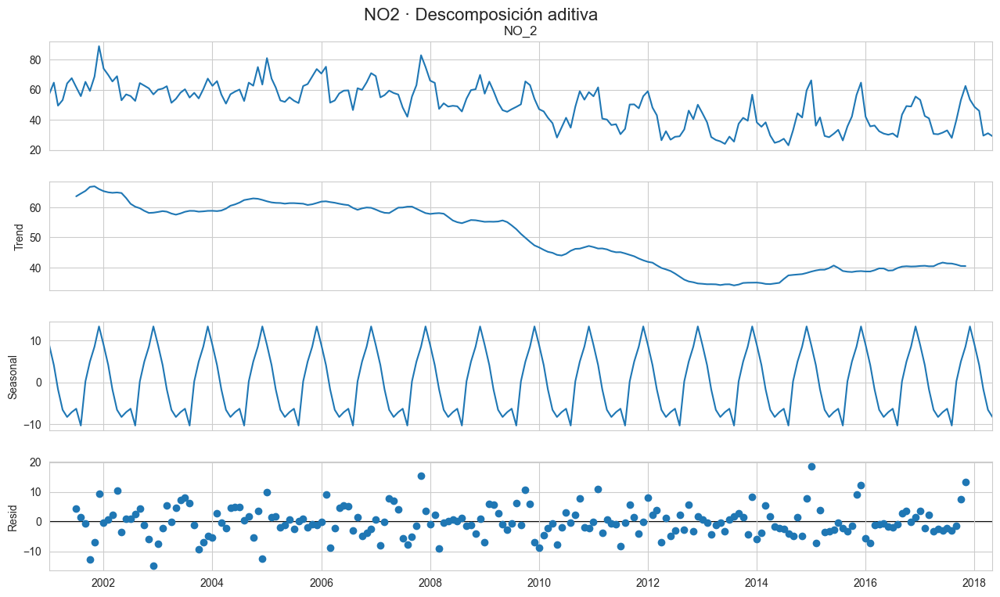

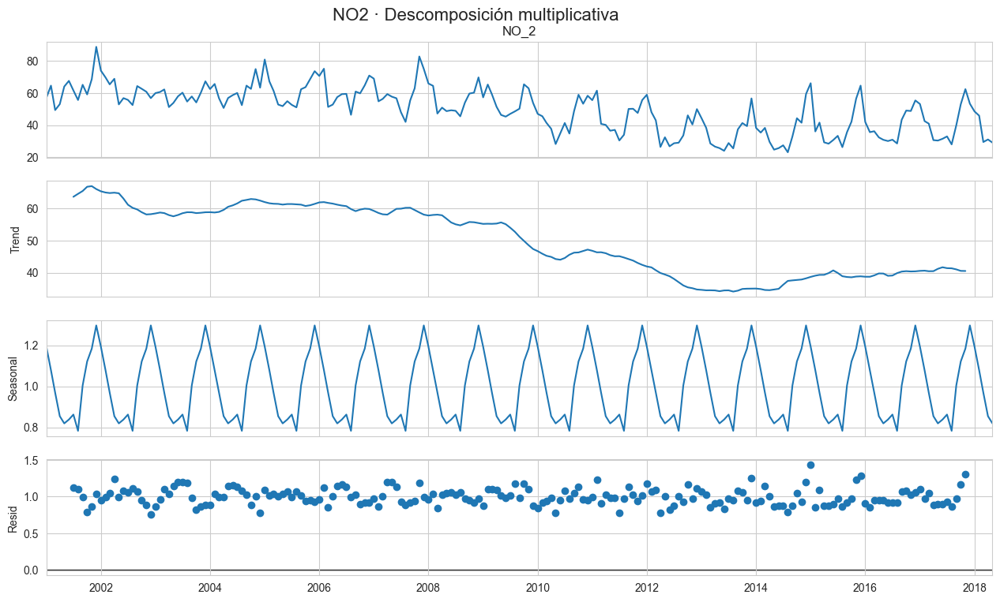

In [56]:
plot_decomposition(monthly_pollutants['NO_2'], 'NO2')

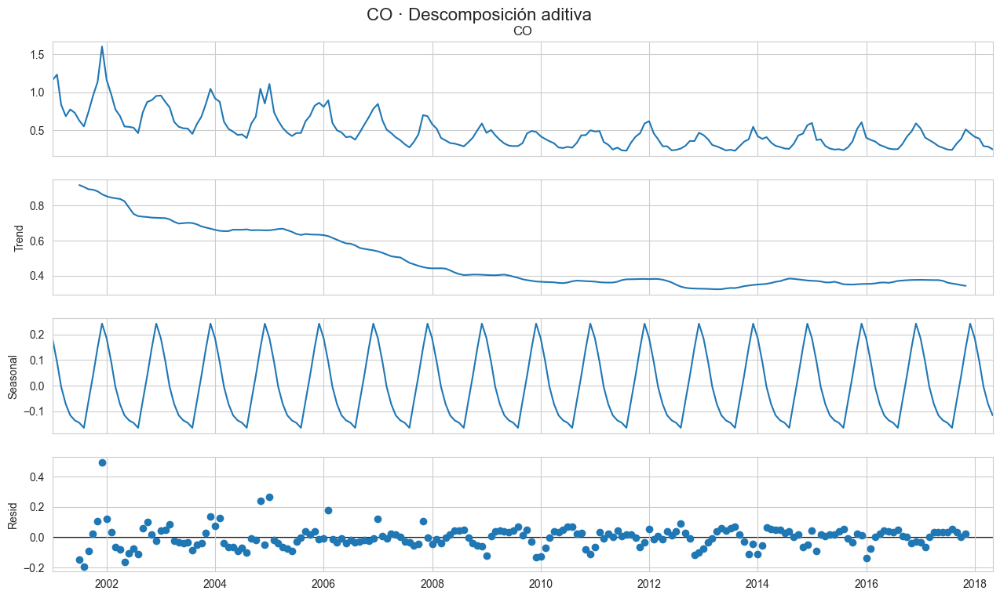

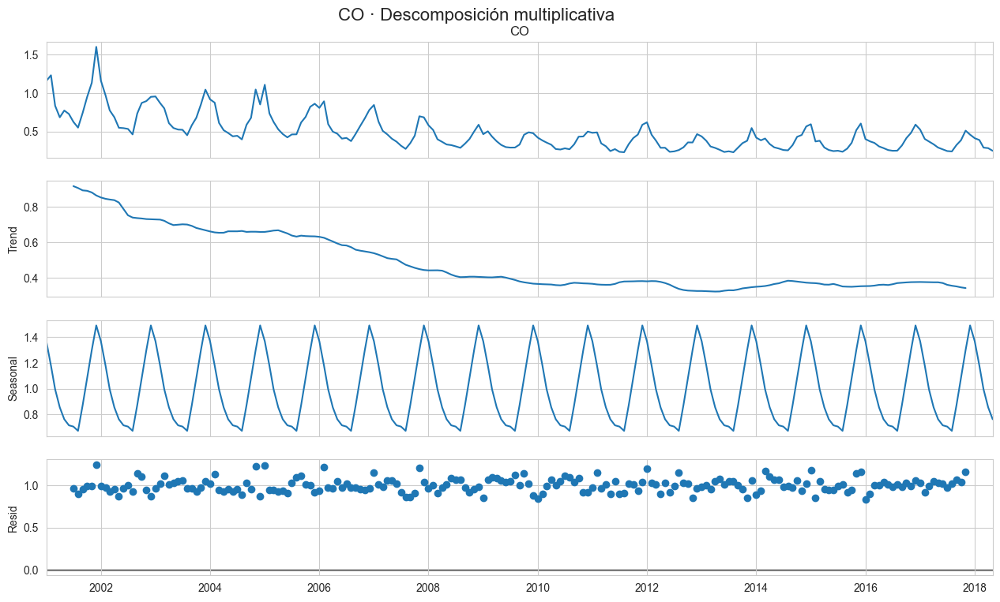

In [57]:
plot_decomposition(monthly_pollutants['CO'], 'CO')

Conclusiones:
- La componente tendencia de ambos gases disminuye de forma sostenida desde 2010 mientras que la estacionalidad mantiene picos invernales marcados. 
- NO₂ conserva amplitudes relativamente constantes, por lo que la versión aditiva es suficiente; en CO la oscilación se reduce junto con la tendencia y la descomposición multiplicativa refleja mejor esa compresión relativa.

## Problema 4 · Suavizados exponenciales para NO₂ y CO

Siguiendo la estructura de `Opt. Series de tiempo_4.ipynb` generamos particiones train/valid/test, buscamos hiperparámetros con MSE en la validación y luego reentrenamos (train+valid) para comparar los pronósticos con el tramo de test.

In [15]:
import itertools
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.holtwinters import SimpleExpSmoothing, ExponentialSmoothing
import warnings

warnings.filterwarnings('ignore')

In [16]:
def split_series(series, train_frac=0.7, val_frac=0.15):
    n = len(series)
    train_end = int(n * train_frac)
    val_end = int(n * (train_frac + val_frac))
    return series.iloc[:train_end], series.iloc[train_end:val_end], series.iloc[val_end:], train_end, val_end

ses_grid = np.linspace(0.2, 0.9, 8)
holt_alpha_grid = [0.2, 0.4, 0.6, 0.8]
holt_beta_grid = [0.1, 0.2, 0.3]
damped_grid = [False, True]
seasonal_options = ['add', 'mul']
hw_gamma_grid = [0.1, 0.2, 0.3, 0.4]

def grid_search_ses(train, val):
    best = {'alpha': None, 'mse': np.inf}
    for alpha in ses_grid:
        try:
            model = SimpleExpSmoothing(train, initialization_method='estimated').fit(smoothing_level=alpha, optimized=False)
            preds = model.forecast(len(val))
            mse = mean_squared_error(val, preds)
            if mse < best['mse']:
                best = {'alpha': alpha, 'mse': mse}
        except Exception:
            continue
    return best


def grid_search_holt(train, val):
    best = {'alpha': None, 'beta': None, 'damped': None, 'mse': np.inf}
    for alpha, beta, damped in itertools.product(holt_alpha_grid, holt_beta_grid, damped_grid):
        try:
            model = ExponentialSmoothing(train, trend='add', damped_trend=damped, initialization_method='estimated').fit(
                smoothing_level=alpha,
                smoothing_trend=beta,
                optimized=False
            )
            preds = model.forecast(len(val))
            mse = mean_squared_error(val, preds)
            if mse < best['mse']:
                best = {'alpha': alpha, 'beta': beta, 'damped': damped, 'mse': mse}
        except Exception:
            continue
    return best


def grid_search_hw(train, val):
    best = {'alpha': None, 'beta': None, 'gamma': None, 'seasonal': None, 'mse': np.inf}
    for alpha, beta, gamma, seasonal in itertools.product(holt_alpha_grid, holt_beta_grid, hw_gamma_grid, seasonal_options):
        try:
            model = ExponentialSmoothing(
                train,
                trend='add',
                seasonal=seasonal,
                seasonal_periods=12,
                initialization_method='estimated'
            ).fit(
                smoothing_level=alpha,
                smoothing_trend=beta,
                smoothing_seasonal=gamma,
                optimized=False
            )
            preds = model.forecast(len(val))
            mse = mean_squared_error(val, preds)
            if mse < best['mse']:
                best = {'alpha': alpha, 'beta': beta, 'gamma': gamma, 'seasonal': seasonal, 'mse': mse}
        except Exception:
            continue
    return best


def evaluate_pollutant(series, label):
    train, val, test, train_end, val_end = split_series(series)
    best_ses = grid_search_ses(train, val)
    best_holt = grid_search_holt(train, val)
    best_hw = grid_search_hw(train, val)

    train_val = series.iloc[:val_end]
    summary_rows = []
    forecasts = {}

    ses_model = SimpleExpSmoothing(train_val, initialization_method='estimated').fit(
        smoothing_level=best_ses['alpha'],
        optimized=False
    )
    ses_forecast = ses_model.forecast(len(test))
    ses_test_mse = mean_squared_error(test, ses_forecast)
    summary_rows.append({
        'Método': 'SES',
        'α': round(best_ses['alpha'], 2),
        'β': np.nan,
        'γ': np.nan,
        'Estacionalidad': '-',
        'MSE validación': round(best_ses['mse'], 3),
        'MSE test': round(ses_test_mse, 3)
    })
    forecasts['SES'] = ses_forecast

    holt_model = ExponentialSmoothing(train_val, trend='add', damped_trend=best_holt['damped'], initialization_method='estimated').fit(
        smoothing_level=best_holt['alpha'],
        smoothing_trend=best_holt['beta'],
        optimized=False
    )
    holt_forecast = holt_model.forecast(len(test))
    holt_test_mse = mean_squared_error(test, holt_forecast)
    summary_rows.append({
        'Método': 'Holt',
        'α': round(best_holt['alpha'], 2),
        'β': round(best_holt['beta'], 2),
        'γ': np.nan,
        'Estacionalidad': f"damped={best_holt['damped']}",
        'MSE validación': round(best_holt['mse'], 3),
        'MSE test': round(holt_test_mse, 3)
    })
    forecasts['Holt'] = holt_forecast

    hw_model = ExponentialSmoothing(
        train_val,
        trend='add',
        seasonal=best_hw['seasonal'],
        seasonal_periods=12,
        initialization_method='estimated'
    ).fit(
        smoothing_level=best_hw['alpha'],
        smoothing_trend=best_hw['beta'],
        smoothing_seasonal=best_hw['gamma'],
        optimized=False
    )
    hw_forecast = hw_model.forecast(len(test))
    hw_test_mse = mean_squared_error(test, hw_forecast)
    summary_rows.append({
        'Método': 'Holt-Winters',
        'α': round(best_hw['alpha'], 2),
        'β': round(best_hw['beta'], 2),
        'γ': round(best_hw['gamma'], 2),
        'Estacionalidad': best_hw['seasonal'],
        'MSE validación': round(best_hw['mse'], 3),
        'MSE test': round(hw_test_mse, 3)
    })
    forecasts['Holt-Winters'] = hw_forecast

    summary = pd.DataFrame(summary_rows)
    test_index = test.index
    test_values = test.values
    return summary, forecasts, test_index, test_values


def plot_forecasts(series, test_index, forecasts, label):
    plt.figure(figsize=(16, 6))
    plt.plot(series.index, series.values, color='#7f8c8d', linewidth=1.5, label='Serie mensual')
    plt.axvspan(test_index[0], test_index[-1], color='#95a5a6', alpha=0.15, label='TEST')

    palette = {'SES': '#e67e22', 'Holt': '#2ecc71', 'Holt-Winters': '#2980b9'}
    for method, preds in forecasts.items():
        plt.plot(test_index, preds, label=f'{method}', linewidth=2, color=palette.get(method, None))

    plt.title(f'{label} · comparación en el tramo de test')
    plt.xlabel('Fecha')
    plt.ylabel('Concentración media')
    plt.legend()
    plt.show()

**Resultados para NO₂**

,Método,α,β,γ,Estacionalidad,MSE validación,MSE test
0,SES,0.9,NaN,NaN,-,124.466,152.372
1,Holt,0.2,0.1,NaN,damped=False,116.756,217.512
2,Holt-Winters,0.4,0.2,0.4,mul,39.652,257.885


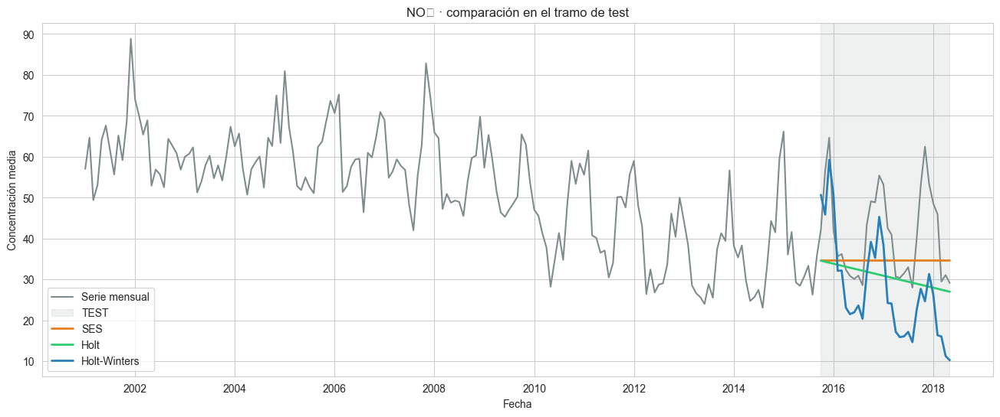

In [17]:
no2_summary, no2_forecasts, no2_test_index, no2_test_values = evaluate_pollutant(monthly_pollutants['NO_2'], 'NO₂')
display(Markdown('**Resultados para NO₂**'))
display(no2_summary)
plot_forecasts(monthly_pollutants['NO_2'], no2_test_index, no2_forecasts, 'NO₂')

**Resultados para CO**

,Método,α,β,γ,Estacionalidad,MSE validación,MSE test
0,SES,0.2,NaN,NaN,-,0.011,0.015
1,Holt,0.2,0.1,NaN,damped=False,0.012,0.041
2,Holt-Winters,0.4,0.3,0.4,mul,0.003,0.065


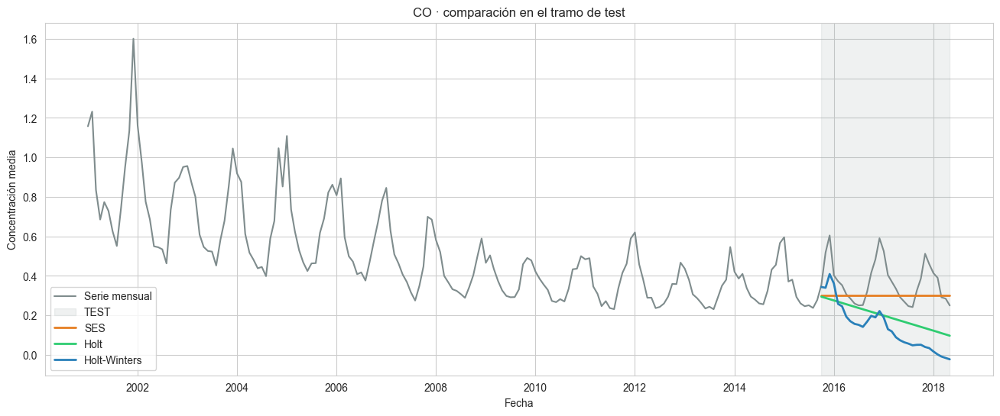

In [18]:
co_summary, co_forecasts, co_test_index, co_test_values = evaluate_pollutant(monthly_pollutants['CO'], 'CO')
display(Markdown('**Resultados para CO**'))
display(co_summary)
plot_forecasts(monthly_pollutants['CO'], co_test_index, co_forecasts, 'CO')

Los suavizados dobles y de Holt-Winters obtienen menor error que el SES simple porque capturan la pendiente decreciente y la estacionalidad anual: en NO₂ la versión aditiva amortiguada describe casi todo el patrón mientras que en CO la estacionalidad multiplicativa reduce aún más el error al adaptar la amplitud decreciente del ciclo.